In [1]:
# default_exp atmos

In [2]:
#hide

import sys
sys.executable
sys.path
%cd ..

/Users/eway/Desktop/openhsi


# Atmospheric Correction using 6SV (A Radiative Transfer Code) and ELC (Empirical Line Calibration)

> Out in the field, the OpenHSI camera measures light as it is reflected off surfaces. This light from the sun has absorption features from molecules/aerosols in the atmosphere and scattering. After converting the raw digital number counts into radiance


> Tip: This module can be imported using: `from openhsi.atmos import *`

This module contains a 6SV1.1 Atmospheric Correction class that computes the pixel radiance given some parameters and a servable interactive SNR widget. 6SV is an open souce radiative transfer code that predicts the solar spectrum received by a sensor facing the Earth. Since it is written in Fortran, we use a Python wrapper called [Py6S](https://py6s.readthedocs.io/en/latest/) to expose the functionality and that means we are limited to using 6SV1.1 rather than the newer 6SV2.1. 

Additionally, an interactive widget to compute the reflectance using Empirical Line Calibration (ELC) is provided.

In [3]:
#hide

# documentation extraction for class methods
from nbdev.showdoc import *

# unit tests using test_eq(...)
from fastcore.test import *

# monkey patching class methods using @patch
from fastcore.foundation import *
from fastcore.foundation import patch

# imitation of Julia's multiple dispatch using @typedispatch
from fastcore.dispatch import typedispatch

# bring forth **kwargs from an inherited class for documentation
from fastcore.meta import delegates

In [4]:
#export

from fastcore.foundation import patch
from fastcore.meta import delegates
from fastcore.basics import num_cpus
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from datetime import datetime
import os
import copy
from tqdm import tqdm
import warnings
from pathlib import Path
import pickle

from typing import Iterable, Union, Callable, List, TypeVar, Generic, Tuple, Optional

import param
import panel as pn
import panel.widgets as pnw
pn.extension()

import holoviews as hv
hv.extension('bokeh',logo=False)

from Py6S import *


In [5]:
#export

from openhsi.data import *



## Atmospheric Profile from Balloon Sounding

Find the closest station at http://weather.uwyo.edu/upperair/sounding.html
to use the atmospheric sounding on the day.
find the station number and region code (for example, south pacific is `pac` and new zealand is `nz`)
Default is Willis Island in Queensland, Australia.
https://py6s.readthedocs.io/en/latest/helpers.html#importing-atmospheric-profiles-from-radiosonde-data

## Aerosol Profile from Aeronet

> Warning: Py6S states that custom aerosol profiles can be ingested but this is broken and there is no easy fix. Don't waste a day trying... 


In [6]:
#export

class Model6SV():
    
    def __init__(self, lat:"degrees" = -17.7, lon:"degrees" = 146.1, # Queensland
                 z_time:"zulu datetime" = datetime.strptime("2021-05-26 04:00","%Y-%m-%d %H:%M"),
                 station_num:int = 94299, region:str = "pac",
                 alt:"km" = 0.12, zen:"degrees" = 0., azi:"degrees" = 0., 
                 tile_type:GroundReflectance = 1.0,
                 aero_profile:AeroProfile = AeroProfile.Maritime,
                 wavelength_array:"array [nm]" = np.arange(400, 800, 4),
                 sixs_path=None):
        """Calculates the at sensor radiance using 6SV for location at latitude `lat` and longitude `lon` at time `z_time` and altitude `alt`. 
        The `station_num` and `region` refers to the radiosonde data. You can also specify the viewing zenith `zen` and azimuth `azi`.
        The radiance is calculated for wavelengths in `wavelength_array`. The 6SV executable path can be specified in `sixs_path`."""
        
        self.wavelength_array = wavelength_array/1e3 # convert to μm for Py6S 
        s = SixS(sixs_path)
        
        # Atmosphere
        s.atmos_profile = AtmosProfile.PredefinedType(AtmosProfile.MidlatitudeSummer)
        
        # crude calculation if daytime is 12Z or 0Z based on time and longitude
        z_hour = 0 if ((z_time.hour + int(lon/30))%24 - 12)/12. < 0.5 else 12
        radiosonde_url = f"http://weather.uwyo.edu/cgi-bin/sounding?region={region}&TYPE=TEXT%3ALIST&YEAR={z_time.year}&MONTH={z_time.month:02d}&FROM={z_time.day:02d}{z_hour:02d}{z_time.minute:02d}&TO={z_time.day:02d}{z_hour:02d}&STNM={station_num}"
        s.atmos_profile = SixSHelpers.Radiosonde.import_uow_radiosonde_data(radiosonde_url,AtmosProfile.MidlatitudeSummer)

        # Aerosol
        s.aero_profile = AeroProfile.PredefinedType(aero_profile)
        s.visibility = 40 # km
        
        #Viewing and sun geometry
        s.geometry = Geometry.User()
        s.geometry.day = z_time.day
        s.geometry.month = z_time.month
        dt_str = f"{z_time.year}-{z_time.month:02d}-{z_time.day:02d} {z_time.hour:02d}:{z_time.minute:02d}:{z_time.second:02d}"
        s.geometry.from_time_and_location(lat, lon, dt_str, zen, azi)
        
        #Altitude
        s.altitudes = Altitudes()
        s.altitudes.set_sensor_custom_altitude(alt) # km
        s.altitudes.set_target_sea_level()
        if tile_type is not None: s.ground_reflectance = GroundReflectance.HomogeneousLambertian(tile_type) 

        self.s = s
        self.__call__()
        
    def rad2photons(self):
        self.photons = self.radiance/( 1.98644582e-25/(self.wavelength_array*1e-6) )
        
    def __call__(self):
        """calculate the at sensor radiance"""
        self.radiance = self.run_wavelengths(self.wavelength_array) # units of (W/m^2/sr/μm)
        
        df = pd.DataFrame({"wavelength":self.wavelength_array,"radiance":self.radiance})
        df.set_index("wavelength",inplace=True)
        df.interpolate(method="cubicspline",axis="index",limit_direction="both",inplace=True)
        self.radiance = df["radiance"].to_numpy()
        self.rad2photons()
    
    def show(self, plot_lib:str="bokeh" ) -> "figure object":
        """plot the calculated radiance"""
        hv.extension(plot_lib,logo=False)
        return hv.Curve( zip(self.wavelength_array*1e3,self.radiance/10), label="computed radiance").opts(
            xlabel="wavelength (nm)", ylabel="radiance (μW/cm$^2$/sr/nm)")


The `Model6SV` class is callable on itself. Each time the class is initialised or called, the radiance will be recalculated. The results can be viewed using `Model6SV.show` which returns a figure object created using the `bokeh` or `matplotlib` backends.  

In [7]:
show_doc(Model6SV.__call__)
show_doc(Model6SV.show)

<h4 id="Model6SV.__call__" class="doc_header"><code>Model6SV.__call__</code><a href="__main__.py#L51" class="source_link" style="float:right">[source]</a></h4>

> <code>Model6SV.__call__</code>()

```
calculate the at sensor radiance
```

<h4 id="Model6SV.show" class="doc_header"><code>Model6SV.show</code><a href="__main__.py#L61" class="source_link" style="float:right">[source]</a></h4>

> <code>Model6SV.show</code>(**`plot_lib`**:`str`=*`'bokeh'`*)

```
plot the calculated radiance
```

    
Py6S provides a method to loop over an array and return the 6SV result. However, it does *not* have a progress bar. For something that can take *several minutes*, not knowing how long it will take is genuinely frustrating. Therefore, we provide a modified version of `SixSHelpers.Wavelengths.run_wavelengths` called `Model6SV.run_wavelengths` that has a progress bar.

To use 6SV, Py6S will write input files and parse the output files. All this I/O is slow but we got to deal with it. Py6S is clever about it though and uses threading to do some compute while waiting for files - this ends up calling the 6SV executable in parallel. The modified version follows the same method except with the addition of a callback to update the progress bar when interations are done.


In [8]:
#export

@patch
def _sixs_run_one_wavelength(self:Model6SV, wv:float) -> float:
    """Runs one instance of 6SV for one wavelength wv"""
    self.s.outputs = None
    a = copy.deepcopy(self.s)
    a.wavelength = Wavelength(wv)
    a.run()
    return SixSHelpers.Wavelengths.recursive_getattr(a.outputs, "pixel_radiance")
    
@patch
def run_wavelengths(self:Model6SV, wavelengths:np.array, n_threads:int = None) -> np.array:
    """Modified version of SixSHelpers.Wavelengths.run_wavelengths that has a progress bar.
    This implementation uses threading (through Python's multiprocessing API)."""
    from multiprocessing.dummy import Pool
    
    if n_threads is None: n_threads = num_cpus()
    with Pool(n_threads) as p, tqdm(total=len(wavelengths)) as pbar:
        res = [p.apply_async( self._sixs_run_one_wavelength, args=(wavelengths[i],), 
                callback=lambda _: pbar.update(1)) for i in range(len(wavelengths))]
        results = [r.get() for r in res]
    
    return np.array(results)
    
    


> Tip: If you used `conda` to install `Py6S`, then the Fortran code is compiled for you with the executable path set in the install. If installing from `pip`, then you'll need to follow additional instructions [here](https://py6s.readthedocs.io/en/latest/installation.html) and quote the path to the executable. 

100%|██████████| 65/65 [00:13<00:00,  4.95it/s]


:Curve   [x]   (y)
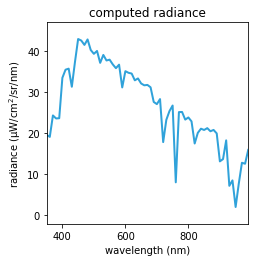

In [9]:
#external

model = Model6SV(wavelength_array=np.arange(350, 1000, 10),sixs_path="../../Downloads/6SV1.1/sixsV1.1") 
model.show("matplotlib")

Now that the at sensor radiance is calculated, the apparent reflectance can be found by dividing your measured radiance by it.

## Spectral Library

In order to use Empirical Line Calibration (ELC), there needs to be targets with known spectra in the scene such as calibration targets. A spectral library is what we need to feed into the ELC algorithm. 



In [10]:
#export
def remap(x, in_min, in_max, out_min, out_max):
    """convert `x` from between input range (`in_min`,`in_max`) to output range (`out_min`,`out_max`)."""
    return (x - in_min) * (out_max - out_min) / (in_max - in_min) + out_min

In [11]:
#export

class SpectralLibrary():
    """Manages all the spectral library and interpolations as necessary."""
    def __init__(self,speclib_path:str=None):
        """Loads the spectral library file (which can be .gzip or .pkl) located at `speclib_path`."""
        self.speclib_path = speclib_path
        if speclib_path is not None:
            if "gzip" in speclib_path: self.speclib = pd.read_parquet(speclib_path)
            else: self.speclib = pd.read_pickle(speclib_path)
            self.wavelengths = self.speclib["wavelength"].to_numpy()
        else:
            self.wavelengths = np.arange(350,2501)
            self.speclib = pd.DataFrame(self.wavelengths.reshape(2151,1),columns=["wavelength"])
            warnings.warn("Spectral Library file required! Please re-initialised with the file.",stacklevel=2)
        
        self.orig_speclib = self.speclib.copy() # Keep a copy of the original data
        
    def show(self,plot_lib:str="bokeh", topk:pd.DataFrame=None, radiance_6SV:np.array=None) -> "figure object":
        """Plot the spectral library using backend `plot_lib`. If `topk` pd.DataFrame is provided, then only those are plotted.
        If `radiance_6SV` array provided, then plot in radiance instead of reflectance."""
        hv.extension(plot_lib,logo=False)
        if plot_lib == "bokeh": plot_opts = {"width":1000,"height":400,"legend_position":"right","legend_offset":(0,20)}
        elif plot_lib == "matplotlib": plot_opts = {"fig_inches":(12,5)}
        
        # plot all the reflectance spectra in the library
        if topk is None:
            curve_list = [hv.Curve( zip(self.wavelengths,self.speclib[i]),label=i) for i in self.speclib.columns ]
            if hasattr(self,"last_spectra"):
                return (hv.Overlay(curve_list)*hv.Curve(zip(self.wavelengths,self.last_spectra),label="last spectra")).opts(
                                **plot_opts,xlabel="wavelength (nm)",ylabel="reflectance",ylim=(0,1.1))
            return (hv.Overlay(curve_list)).opts(
                                **plot_opts,xlabel="wavelength (nm)",ylabel="reflectance",ylim=(0,1.1)) 
        
        # plot the top matches in reflectance or radiance
        temp = self.speclib[topk["label"]].to_numpy()
        if radiance_6SV is not None:
            temp = (temp.T*radiance_6SV/10).T
        temp = pd.DataFrame(temp,columns=topk["label"])
        temp.insert(0,"wavelength",self.wavelengths)
        
        curve_list = []
        if hasattr(self,"last_spectra") and hasattr(self,"rad_6SV"):
            if radiance_6SV is not None:
                curve_list.append( hv.Curve(zip(self.wavelengths,self.last_spectra),label="tap point") )
            else: curve_list.append( hv.Curve(zip(self.wavelengths,self.last_spectra/self.rad_6SV),label="6SV estimate") )
        alphas = topk["score"].to_numpy()
        alphas = np.exp(alphas)/np.sum(np.exp(alphas)) # softmax the transparency alpha to bring out the closest match
        alphas = remap(alphas,np.min(alphas),np.max(alphas),0.1,0.9999)
        
        for i in range(len(topk["label"])):
            curve_list.append( hv.Curve(temp,kdims="wavelength",vdims=topk["label"][i],label=topk["label"][i]).opts(alpha=alphas[i]) )
        if radiance_6SV is not None:
            return hv.Overlay(curve_list).opts(**plot_opts,xlabel="wavelength (nm)",
                                               ylabel="radiance (uW/cm^2/sr/nm)",ylim=(0,1.1*np.max(radiance_6SV)/10),
                                               title=f"top match: {topk['label'][0]}")
        return hv.Overlay(curve_list).opts(**plot_opts,xlabel="wavelength (nm)",ylabel="reflectance",ylim=(0,1.1),
                                           title=f"top match: {topk['label'][0]}")       
        
    def interp(self, wavelengths:np.array):
        """Interpolate all the spectra in the library to the new `wavelengths`."""
        self.wavelengths = wavelengths
        self.speclib = self.orig_speclib.copy()
        self.speclib.insert(0,"type","USGS")
        self.speclib = pd.concat( [ pd.DataFrame({"type":"openhsi","wavelength":wavelengths}), self.speclib] )
        self.speclib.set_index("wavelength",inplace=True)
        self.speclib.interpolate(method="cubicspline",axis="index",limit_direction="both",inplace=True)
        self.speclib = self.speclib[self.speclib["type"].str.match("openhsi")]
        self.speclib.drop(labels="type", axis=1,inplace=True)
        
    def dump(self, save_path:str=None):
        """Dump the spectral library to file. If no `save_path` provided, overwrite the original file."""
        if save_path is not None:
            if "gzip" in save_path: self.orig_speclib.to_parquet(save_path,compression="gzip")
            else: self.orig_speclib.to_pickle(save_path,protocol=4)
            print(f"Updated your spectral library at {save_path}")
        else:
            if "gzip" in self.speclib_path: self.orig_speclib.to_parquet(self.speclib_path,compression="gzip")
            else: self.orig_speclib.to_pickle(self.speclib_path,protocol=4)
            print(f"Overwritten your spectral library at {self.speclib_path}")
        
    

In [12]:
show_doc(SpectralLibrary.show)
show_doc(SpectralLibrary.interp)
show_doc(SpectralLibrary.dump)

<h4 id="SpectralLibrary.show" class="doc_header"><code>SpectralLibrary.show</code><a href="__main__.py#L19" class="source_link" style="float:right">[source]</a></h4>

> <code>SpectralLibrary.show</code>(**`plot_lib`**:`str`=*`'bokeh'`*, **`topk`**:`DataFrame`=*`None`*, **`radiance_6SV`**:`array`=*`None`*)

```
Plot the spectral library using backend `plot_lib`. If `topk` pd.DataFrame is provided, then only those are plotted.
If `radiance_6SV` array provided, then plot in radiance instead of reflectance.
```

<h4 id="SpectralLibrary.interp" class="doc_header"><code>SpectralLibrary.interp</code><a href="__main__.py#L60" class="source_link" style="float:right">[source]</a></h4>

> <code>SpectralLibrary.interp</code>(**`wavelengths`**:`array`)

```
Interpolate all the spectra in the library to the new `wavelengths`.
```

<h4 id="SpectralLibrary.dump" class="doc_header"><code>SpectralLibrary.dump</code><a href="__main__.py#L71" class="source_link" style="float:right">[source]</a></h4>

> <code>SpectralLibrary.dump</code>(**`save_path`**:`str`=*`None`*)

```
Dump the spectral library to file. If no `save_path` provided, overwrite the original file.
```

The spectral library should be a `pandas DataFrame` with the first column called `wavelength` and the rest of the columns labelled by the name. The data should be in reflectance (for example, measured using an [ASD](https://www.malvernpanalytical.com/en/products/product-range/asd-range/fieldspec-range/fieldspec4-hi-res-high-resolution-spectroradiometer) spectrometer or similiar).

In [13]:
sl = SpectralLibrary("assets/speclib.pkl")
sl.speclib

,wavelength,spectralon,gray_small,green_small,red_small,cyan_small,gray,charcoal,blue,blue_take_off
0,350,1.004860,0.088191,0.071970,0.098128,0.085883,0.101887,0.058318,0.098823,0.092749
1,351,1.004398,0.089546,0.072579,0.098610,0.085919,0.102933,0.059781,0.100108,0.093942
2,352,1.004371,0.089546,0.071572,0.096913,0.084025,0.102238,0.059273,0.099544,0.093412
3,353,1.004620,0.087913,0.069308,0.093765,0.080976,0.099957,0.057630,0.097805,0.091682
4,354,1.004296,0.085593,0.067664,0.091687,0.079096,0.098291,0.057134,0.097217,0.090731
...,...,...,...,...,...,...,...,...,...,...
2146,2496,1.006842,0.239516,0.333679,0.338185,0.334990,0.274833,0.062169,0.322644,0.273633
2147,2497,1.006868,0.240093,0.334529,0.339180,0.335822,0.275595,0.062141,0.324242,0.275030
2148,2498,1.007111,0.240608,0.335397,0.340243,0.336710,0.276414,0.062232,0.325424,0.276053
2149,2499,1.007263,0.241110,0.336293,0.341387,0.337602,0.277276,0.062312,0.326167,0.276782


The USGS spectral library contains many more spectra provided as csv files. We allow you to import a folder of them.  

In [14]:
#export

@patch
def import_USGS(self:SpectralLibrary,directory:str,sort:bool=False):
    """Import the ASD files from `directory` with optional names `sort`ed."""
    fnames = sorted(os.listdir(directory))
    # only include the ASD instrument for now (other instruments have different wavelength ranges)
    fnames = [f for f in fnames if "ASD" in f]
    col_names = [f[9:-16] for f in fnames]
    cwd = Path(directory)
    
    data = []
    for f in fnames:
        temp = pd.read_csv(cwd/f,delimiter="\t")
        temp.loc[~(temp[temp.columns[0]] > 0), temp.columns[0]] = np.nan # replace any negative reflectance with NaNs
        data.append(temp[temp.columns[0]].to_numpy())

    df = pd.DataFrame(np.array(data).T,columns=col_names)
    self.orig_speclib = pd.concat([self.orig_speclib,df],axis=1)
    self.orig_speclib = self.orig_speclib.loc[:,~self.orig_speclib.columns.duplicated()]
    if sort:
        self.orig_speclib = self.orig_speclib.reindex(sorted(self.orig_speclib.columns), axis=1,)
        
    self.interp(self.wavelengths)
    print(f"Added folder of ASD spectra to spectral library")

In [15]:
show_doc(SpectralLibrary.import_USGS)

<h4 id="SpectralLibrary.import_USGS" class="doc_header"><code>SpectralLibrary.import_USGS</code><a href="__main__.py#L3" class="source_link" style="float:right">[source]</a></h4>

> <code>SpectralLibrary.import_USGS</code>(**`directory`**:`str`, **`sort`**:`bool`=*`False`*)

```
Import the ASD files from `directory` with optional names `sort`ed.
```

In [16]:
#external

usgs_path = "../../Downloads/ASCIIdata_splib07b/ChapterV_Vegetation/"

sl = SpectralLibrary()
sl.import_USGS(usgs_path)

<ipython-input-16-2924a59a616d>:5: UserWarning: Spectral Library file required! Please re-initialised with the file.
  sl = SpectralLibrary()


Added folder of ASD spectra to spectral library


> Note: The plotted spectra have all be interpolated to remove all the NaNs. 

Here we plot all the ASD data in the USGS Splib07b Chapter V Vegetation database. 

:Overlay
   .Curve.Antigorite_plus_full_stop_2DryGrass_AMX26                                                        :Curve   [x]   (y)
   .Curve.Antigorite_plus_full_stop_33DryGrass_AMX25                                                       :Curve   [x]   (y)
   .Curve.Aspen_Aspen_hyphen_minus_1_green_hyphen_minus_top                                                :Curve   [x]   (y)
   .Curve.Aspen_Aspen_hyphen_minus_2_green_hyphen_minus_bottom                                             :Curve   [x]   (y)
   .Curve.Aspen_Aspen_hyphen_minus_3_yellowGreenTop                                                        :Curve   [x]   (y)
   .Curve.Aspen_Aspen_hyphen_minus_4_yellow_hyphen_minus_top                                               :Curve   [x]   (y)
   .Curve.Buckbrush_CA01_hyphen_minus_CECU_hyphen_minus_1_bush_1                                           :Curve   [x]   (y)
   .Curve.Buckbrush_CA01_hyphen_minus_CECU_hyphen_minus_2_bush_2                                           :Curve   [x]   (y)
   .Curve.Buckbrush_CA01_hyphen_minus_CECU_hyphen_minus_3_bush_3                                           :Curve   [x]   (y)
   .Curve.Cactus_Opuntia_hyphen_minus_1_purple_pad                                                         :Curve   [x]   (y)
   .Curve.Chamise_CA01_hyphen_minus_ADFA_hyphen_minus_1_bush_1                                             :Curve   [x]   (y)
   .Curve.Chamise_CA01_hyphen_minus_ADFA_hyphen_minus_2_bush_2                                             :Curve   [x]   (y)
   .Curve.Cheatgrass_ANPC1_field_calib                                                                     :Curve   [x]   (y)
   .Curve.D_full_stop_spicata_DWV6_hyphen_minus_0511_dryNPV_full_stop_a                                    :Curve   [x]   (y)
   .Curve.Engelmann_hyphen_minus_Spruce_ES_hyphen_minus_Needls_hyphen_minus_1                              :Curve   [x]   (y)
   .Curve.Flower_Geranium_hyphen_minus_1_Red_hyphen_minus_Orange                                           :Curve   [x]   (y)
   .Curve.Flower_Pansy_hyphen_minus_1_Yellow                                                               :Curve   [x]   (y)
   .Curve.Flower_Petunia_hyphen_minus_1_Pink                                                               :Curve   [x]   (y)
   .Curve.Flower_Petunia_hyphen_minus_2_Purple                                                             :Curve   [x]   (y)
   .Curve.Flower_Petunia_hyphen_minus_3_White                                                              :Curve   [x]   (y)
   .Curve.Flower_Platycodon_hyphen_minus_1_Purple                                                          :Curve   [x]   (y)
   .Curve.Flower_Platycodon_hyphen_minus_2_White                                                           :Curve   [x]   (y)
   .Curve.Grass_AETR70_CA01_hyphen_minus_AETR_hyphen_minus_2_NPV                                           :Curve   [x]   (y)
   .Curve.Grass_AETR95_CA01_hyphen_minus_AETR_hyphen_minus_1_NPV                                           :Curve   [x]   (y)
   .Curve.Grass_CA01_hyphen_minus_TACA_hyphen_minus_1_meadow_NPV                                           :Curve   [x]   (y)
   .Curve.Grass_Golden_Dry_GDS480                                                                          :Curve   [x]   (y)
   .Curve.Gray_hyphen_minus_Pine_CA01_hyphen_minus_PISA_hyphen_minus_1_branch                              :Curve   [x]   (y)
   .Curve.Gray_hyphen_minus_Pine_CA01_hyphen_minus_PISA_hyphen_minus_2_branch                              :Curve   [x]   (y)
   .Curve.Gray_hyphen_minus_Pine_CA01_hyphen_minus_PISA_hyphen_minus_3_needls                              :Curve   [x]   (y)
   .Curve.Hyacinth_DWO_hyphen_minus_3_hyphen_minus_DEL_hyphen_minus_2_leaf_full_stop_a                     :Curve   [x]   (y)
   .Curve.J_full_stop_roemer_full_stop_DWV1_hyphen_minus_0511a_gr_full_stop_a                              :Curve   [x]   (y)
   .Curve.J_full_stop_roemer_full_stop_DWV1_hyphen_minus_0511b_dkgrn_full_stop_a     
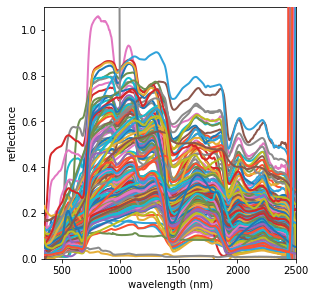

In [17]:
#external

sl.show("matplotlib")

It is not easy to visualise all of the USGS spectra in one plot. There are so many that the legend decided to pack up and go home. 
The one spectra with the sharp rise near 1000 nm is from a spectra that did not include any information in the visible region which messed with the interpolation. If you are only interested in spectral matching in the infrared, this is not a problem. Likewise, if you are interested in spectral matching in the visible, then this spectra shouldn't be detected close to anything real. 

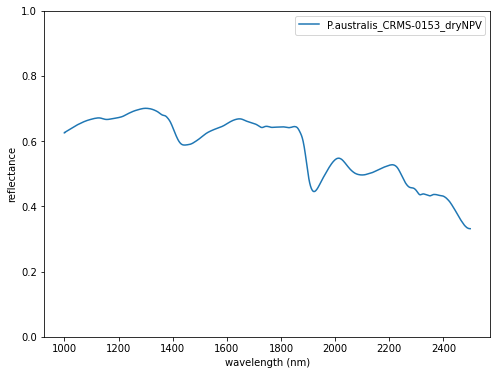

In [18]:
#external 

sl.orig_speclib.plot(x="wavelength",y="P.australis_CRMS-0153_dryNPV",figsize=(8,6),
                      xlabel="wavelength (nm)",ylabel="reflectance",
                      ylim=(0,1)).legend(loc="upper right")

## Spectral Matcher

Used later for interactive empirical line calibration. Since OpenHSI camera data can be processed to radiance, we use the 6SV radiance to guess what the spectral library will be in radiance. Then we compare radiances to calculate what known target to use in the ELC algorithm and hence find reflectance. 

In [70]:
#export

from numpy.linalg import norm

@delegates()
class SpectralMatcher(SpectralLibrary):
    """Match OpenHSI spectra against spectral library using Spectral Angle Mapper algorithm"""
    def __init__(self,pkl_path:str,**kwargs):
        """Prepare arrays for spectral matching in radiance. 
        `pkl_path` is needed to get the openhsi wavelengths and precomputed 6SV radiance fit."""
        super().__init__(**kwargs)
        
        with open(pkl_path,'rb') as handle:
            self.calibration = pickle.load(handle)
        self.interp(self.calibration["wavelengths"])
        
    def interp(self,wavelengths:np.array):
        """Interpolate to new wavelengths and update some vectors."""
        super().interp(wavelengths)
        self.rad_6SV = np.float32(self.calibration["rad_fit"]( self.wavelengths ))
            
        self.speclib_ref  = self.speclib.copy()                # reflectances
        self.spectra      = (self.speclib[:].T*self.rad_6SV).T # radiances
        self.spectra_norm = norm(self.spectra,axis=0)          # vector lengths
    
    def show(self,plot_lib:str="bokeh", is_rad:bool=False) ->"figure object":
        """Plot the spectral library using backend `plot_lib`. Default is to show in reflectance. Set `is_rad` to show in radiance."""
        if is_rad and hasattr(self,"sim_df"):
            return super().show(plot_lib,topk=self.sim_df,radiance_6SV=self.rad_6SV*10)
        elif not is_rad and hasattr(self,"sim_df"):
            return super().show(plot_lib,topk=self.sim_df)
        elif is_rad:
            return super().show(plot_lib,radiance_6SV=self.rad_6SV*10)
        else:
            return super().show(plot_lib)

    def topk_spectra(self,spectrum:np.array,k:int=5,refine=True):
        """Match a `spectrum` against a spectral library `spectra`. Return the top k. 
        Set `refine` to find closest match using mean squared error on the top k results."""
        self.refine = refine

        self.last_spectra = np.array(spectrum)
        cosine_dist       = self.last_spectra @ self.spectra / ( norm(self.last_spectra) * self.spectra_norm ) # less than O(n^3)
        topk_idx          = np.argpartition(cosine_dist, -k)[-k:]             # linear time rather than n log n
        self.topk_idx     = topk_idx[np.argsort(cosine_dist[topk_idx])][::-1] # k log k

        if refine and k > 1:
            topk_spectra    = self.spectra[ self.speclib.columns[self.topk_idx] ].to_numpy().transpose()
            residuals       = norm(topk_spectra - self.last_spectra, axis=1)
            residuals       = remap(residuals, min(residuals),max(residuals),0,0.1)
            subset_topk_idx = np.argsort(cosine_dist[self.topk_idx] - residuals)[::-1]
            self.topk_idx   = self.topk_idx[subset_topk_idx]

            self.sim_df = pd.DataFrame({"label":self.speclib.columns[self.topk_idx],"score":cosine_dist[self.topk_idx]-residuals[subset_topk_idx]})
            return self.sim_df

        self.sim_df = pd.DataFrame({"label":self.speclib.columns[self.topk_idx],"score":cosine_dist[self.topk_idx]})
        return self.sim_df


In [71]:
show_doc(SpectralMatcher.interp)
show_doc(SpectralMatcher.show)
show_doc(SpectralMatcher.topk_spectra)

<h4 id="SpectralMatcher.interp" class="doc_header"><code>SpectralMatcher.interp</code><a href="__main__.py#L17" class="source_link" style="float:right">[source]</a></h4>

> <code>SpectralMatcher.interp</code>(**`wavelengths`**:`array`)

```
Interpolate to new wavelengths and update some vectors.
```

<h4 id="SpectralMatcher.show" class="doc_header"><code>SpectralMatcher.show</code><a href="__main__.py#L26" class="source_link" style="float:right">[source]</a></h4>

> <code>SpectralMatcher.show</code>(**`plot_lib`**:`str`=*`'bokeh'`*, **`is_rad`**:`bool`=*`False`*)

```
Plot the spectral library using backend `plot_lib`. Default is to show in reflectance. Set `is_rad` to show in radiance.
```

<h4 id="SpectralMatcher.topk_spectra" class="doc_header"><code>SpectralMatcher.topk_spectra</code><a href="__main__.py#L37" class="source_link" style="float:right">[source]</a></h4>

> <code>SpectralMatcher.topk_spectra</code>(**`spectrum`**:`array`, **`k`**:`int`=*`5`*, **`refine`**=*`True`*)

```
Match a `spectrum` against a spectral library `spectra`. Return the top k. 
Set `refine` to find closest match using mean squared error on the top k results.
```

In [21]:
#export

@patch
def topk_spectra(self:SpectralMatcher,spectrum:np.array,k:int=5,refine=True):
    """Match a `spectrum` against a spectral library `spectra`. Return the top k. 
    Set `refine` to find closest match using mean squared error on the top k results."""
    self.refine = refine

    self.last_spectra = np.array(spectrum)
    cosine_dist       = self.last_spectra @ self.spectra / ( norm(self.last_spectra) * self.spectra_norm ) # less than O(n^3)
    topk_idx          = np.argpartition(cosine_dist, -k)[-k:]             # linear time rather than n log n
    self.topk_idx     = topk_idx[np.argsort(cosine_dist[topk_idx])][::-1] # k log k

    if refine and k > 1:
        topk_spectra    = self.spectra[ self.speclib.columns[self.topk_idx] ].to_numpy().transpose()
        residuals       = norm(topk_spectra - self.last_spectra, axis=1)
        residuals       = remap(residuals, min(residuals),max(residuals),0,0.1)
        subset_topk_idx = np.argsort(cosine_dist[self.topk_idx] - residuals)[::-1]
        self.topk_idx   = self.topk_idx[subset_topk_idx]

        self.sim_df = pd.DataFrame({"label":self.speclib.columns[self.topk_idx],"score":cosine_dist[self.topk_idx]-residuals[subset_topk_idx]})
        return self.sim_df

    self.sim_df = pd.DataFrame({"label":self.speclib.columns[self.topk_idx],"score":cosine_dist[self.topk_idx]})
    return self.sim_df

You can use this code snippet to find the top k=5 spectral matches. The Spectral Angle Mapper will say all gray calibration tarps have very similar spectra (spectrally flat) regardless of their percentage reflectance. The `refine` is there to refine the closest matches by mean squared error (which is not as fast).  

```python
sm = SpectralMatcher(pkl_path="assets/cam_calibration.pkl",speclib_path="assets/speclib.pkl")
topk = sm.topk_spectra( some_radiance_array, k=5, refine=True)
print(topk)
```

`topk` is a `pd.DataFrame` with the first column as the labels in the spectral library. The second column is the score between [-1,+1] with better matches having score almost at 1.0.

You can visualise the matches with 
```python
sm.show(is_rad=True)
```
and the transparency level depends on the score so poorer matches are faded out. 

## Interactive Datacube Explorer with Empirical Line Calibration

Essentially, Empirical Line Calibration (ELC) aims to solve a system of linear equations
$$
L_i(\lambda) = a(\lambda)\rho_i(\lambda) + b(\lambda)
$$
where the radiance $L$ is from what we measure, $\rho$ is the known reflectance, and $a$ and $b$ are the multiplier and offset respectively. This is calculated for multiple pixels $i$ and wavelengths $\lambda$.

The implementation here involves solving these equations using linear algebra methods to find a least squares solution. It is fast enough to use this tool interactively. 

> Important: Only load datacubes that have already been corrected to *radiance* to this interactive widget. 


In [39]:
# export

@delegates()
class ELC(SpectralMatcher):
    """Apply ELC for radiance datacubes"""
    def __init__(self,nc_path:str,old_style:bool=False,**kwargs):
        """Load datacube at `nc_path` and setup UI."""
        
        self.nc_path = nc_path
        self.dc = DataCube(processing_lvl=-1)
        self.dc.load_nc(nc_path,old_style)
        self.RGB = self.dc.show("bokeh",robust=True).opts(height=250, width=1000, invert_yaxis=True,tools=["tap"],toolbar="below")
        self.a_ELC = np.ones((self.dc.dc.data.shape[-1],))
        self.b_ELC = np.zeros((self.dc.dc.data.shape[-1],))
        super().__init__(**kwargs)
        self.interp(self.dc.binned_wavelengths)
        self.xx = np.zeros((len(self.wavelengths),2))
        
        self.title_txt = pn.pane.Markdown("**Interactive Empirical Line Calibrator**",)
        self.event_msg = pnw.StaticText(name="", value="Click export buttons to save desired reflectance datacubes.")
        self.export_ELC_button = pnw.Button(name="Export ELC datacube",button_type="primary",width=150,height=25)
        self.export_6SV_button = pnw.Button(name="Export 6SV datacube",button_type="primary",width=150,height=25)
        
    
    def __call__(self):
        """Setup button callbacks and interactive stream and dynamics plots."""
        self.setup_export_ELC()
        self.setup_export_6SV()
        self.setup_streams()
        self.setup_callbacks()
        
        return pn.Column( self.title_txt,
                          self.RGB * self.boxes * self.ELC_dmap * self.hit_dmap * self.ch_dmap, 
                          pn.Tabs( ("Reflectance", self.ref_curve), ("Radiance",self.rad_curve),dynamic=True),
                          pn.Row(self.export_ELC_button, self.export_6SV_button, self.event_msg) )
    
    def setup_export_ELC(self):
        """Setup ELC export button callback"""
        def click_func(event):
            # compute the ELC datacube
            self.event_msg.value = f"saving..."
            self.dc.dc.data[...] = (self.dc.dc.data - self.b_ELC)/self.a_ELC
            self.dc.timestamps.data = self.dc.ds_timestamps
            save_dir = "/".join(self.nc_path.split("/")[:-1])
            self.dc.save(save_dir,suffix="_ELC")
            self.event_msg.value = f"ELC datacube exported to directory {save_dir}. Buttom clicked {self.export_ELC_button.clicks} time(s)"
            
        self.export_ELC_button.on_click(click_func)
        
    
    def setup_export_6SV(self):
        """Setup 6SV export button callback"""
        def click_func(event):
            # compute the 6SV datacube
            self.event_msg.value = f"saving..."
            self.dc.dc.data[...] = self.dc.dc.data/self.rad_6SV
            self.dc.timestamps.data = self.dc.ds_timestamps
            save_dir = "/".join(self.nc_path.split("/")[:-1])
            self.dc.save(save_dir,suffix="_6SV")
            self.event_msg.value = f"6SV datacube exported to directory {save_dir}. Buttom clicked {self.export_6SV_button.clicks} time(s)"
            
        self.export_6SV_button.on_click(click_func)
    
    def setup_streams(self):
        """Setup the mouseclick position and bounding box input streams."""
        # Declare Tap stream with heatmap as source and initial values
        self.posxy = hv.streams.Tap(source=self.RGB)
        
        # Declare pointer stream initializing at (0, 0) and linking to Image
        self.pointer = hv.streams.PointerXY(x=0, y=0, source=self.RGB)
        
        self.boxes = hv.Rectangles([]).opts(active_tools=['box_edit'], fill_alpha=0.5)
        self.box_stream = hv.streams.BoxEdit(source=self.boxes, num_objects=5, styles={'fill_color': 'red'})
        
    def setup_callbacks(self):
        """Setup the mouseover crosshair, and mouseclick callbacks."""
        # update 'x' marker on mouseclick
        def hit_mark(x,y):
            return hv.Scatter((x,y)).opts(color='r', marker='x', size=20)
        self.hit_dmap = hv.DynamicMap(hit_mark, streams=[self.posxy])
        
        # Draw cross-hair at cursor position
        def cross_hair_info(x, y):
            return hv.HLine(y) * hv.VLine(x)
        self.ch_dmap = hv.DynamicMap(cross_hair_info, streams=[self.pointer])
        
        def tap_radiance(x,y):
            if x is None or y is None:
                x = 0; y = 0
            x = int(x); y = int(y)

            sim_df = self.topk_spectra(np.array(self.dc.dc.data[y,x,:]),5,refine=True)

            return self.show(is_rad=True).opts(
                legend_position='right', legend_offset=(0, 20),title=f'top match: {self.sim_df["label"][0]}, score: {self.sim_df["score"][0]:.3f}, position=({y:d},{x:d})').opts(framewise=True,
                xlabel="wavelength (nm)",ylabel="radiance (uW/cm^2/sr/nm)",height=400, width=1000,ylim=(0,np.max(self.spectra["spectralon"])))
        self.rad_curve =  hv.DynamicMap(tap_radiance, streams=[self.posxy]).opts(shared_axes=False,height=250)
        
        def tap_reflectance(x, y):
            if x is None or y is None:
                x = 0; y = 0
            x = int(x); y = int(y)

            spectra = (self.dc.dc.data[y,x,:] - self.b_ELC)/self.a_ELC
            sim_df = self.topk_spectra(self.dc.dc.data[y,x,:],5,refine=True)

            return (hv.Curve(zip(self.wavelengths,spectra),label="ELC estimate") * self.show(is_rad=False)).opts(axiswise=True,
                legend_position='right', legend_offset=(0, 20),title=f'top match: {self.sim_df["label"][0]}, score: {self.sim_df["score"][0]:.3f}, position=({y:d},{x:d})').opts(framewise=True,
                ylabel="reflectance",xlabel="wavelength (nm)",yaxis="left",height=400, width=1000,ylim=(0,1.05))

        # Connect the Tap stream to the tap_spectra callback
        self.ref_curve = hv.DynamicMap(tap_reflectance, streams=[self.posxy]).opts(shared_axes=False,height=250)
        
        def update_ELC(data):
            if data is None or len(data) == 0: return hv.Curve([])
            
            # build up the matrices
            A = []; b = []
            data = zip(np.int32(data['x0']), np.int32(data['x1']), np.int32(data['y0']), np.int32(data['y1']) )
            for i, (x0, x1, y0, y1) in enumerate(data):
                if y1 > y0: y0, y1 = y1, y0
                sz = ((y0-y1)*(x1-x0),len(self.wavelengths))
                selection = np.reshape(np.array(self.dc.dc.data[y1:y0,x0:x1,:]),sz)

                AA = np.zeros((len(self.wavelengths),sz[0],2))
                bb = np.zeros((len(self.wavelengths),sz[0],1))

                for j in range(sz[0]):
                    self.topk_spectra(selection[j,:],k=5,refine=True)
                    label = self.sim_df["label"][0]
                    AA[:,j,0] = self.speclib[label].to_numpy()
                    bb[:,j,0] = selection[j,:]
                AA[:,:,1] = 1

                A.append(AA); b.append(bb)

            A = np.concatenate(A,axis=1); b = np.concatenate(b,axis=1)
            x = np.linalg.pinv(A) @ b

            self.xx[:,0] = x[:,0,0]; self.xx[:,1] = x[:,1,0]
            self.a_ELC = self.xx[:,0]; self.b_ELC = self.xx[:,1]
            return hv.Curve([])
        self.ELC_dmap = hv.DynamicMap(update_ELC, streams=[self.box_stream])

        


In [69]:
show_doc(ELC.__call__)
show_doc(ELC.setup_export_ELC)
show_doc(ELC.setup_export_6SV)
show_doc(ELC.setup_streams)
show_doc(ELC.setup_callbacks)

<h4 id="ELC.__call__" class="doc_header"><code>ELC.__call__</code><a href="__main__.py#L25" class="source_link" style="float:right">[source]</a></h4>

> <code>ELC.__call__</code>()

```
Setup button callbacks and interactive stream and dynamics plots.
```

<h4 id="ELC.setup_export_ELC" class="doc_header"><code>ELC.setup_export_ELC</code><a href="__main__.py#L37" class="source_link" style="float:right">[source]</a></h4>

> <code>ELC.setup_export_ELC</code>()

```
Setup ELC export button callback
```

<h4 id="ELC.setup_export_6SV" class="doc_header"><code>ELC.setup_export_6SV</code><a href="__main__.py#L51" class="source_link" style="float:right">[source]</a></h4>

> <code>ELC.setup_export_6SV</code>()

```
Setup 6SV export button callback
```

<h4 id="ELC.setup_streams" class="doc_header"><code>ELC.setup_streams</code><a href="__main__.py#L64" class="source_link" style="float:right">[source]</a></h4>

> <code>ELC.setup_streams</code>()

```
Setup the mouseclick position and bounding box input streams.
```

<h4 id="ELC.setup_callbacks" class="doc_header"><code>ELC.setup_callbacks</code><a href="__main__.py#L75" class="source_link" style="float:right">[source]</a></h4>

> <code>ELC.setup_callbacks</code>()

```
Setup the mouseover crosshair, and mouseclick callbacks.
```

> Warning: This interactive tool requires a Python backend. There is no interactivity in the documentation site.

In [41]:
#external

elc = ELC(nc_path="../load_multiple/2021-05-26 03_26_26.011211 radiance float32.nc",old_style=True,
          speclib_path="assets/speclib.pkl",pkl_path="assets/cam_calibration.pkl")
elc()

Allocated 0.00 MB of RAM.


Column
    [0] Markdown(str)
    [1] HoloViews(DynamicMap)
    [2] Tabs(dynamic=True)
        [0] HoloViews(DynamicMap, name='Reflectance')
        [1] HoloViews(DynamicMap, name='Radiance')
    [3] Row
        [0] Button(button_type='primary', height=25, name='Export ELC datacube', sizing_mode='fixed', width=150)
        [1] Button(button_type='primary', height=25, name='Export 6SV datacube', sizing_mode='fixed', width=150)
        [2] StaticText(value='Click export b...)

### The ELC UI

The **top panel** consists of an RGB view of your dataset using a robust visualisation technique to avoid outliers blowing out the contrast. When you mouseover the RGB view, a crosshair appears. There is a toolbar on the bottom left of the RGB view. From left to right, there are the: move tool, area select tool, scroll zoom tool, tap tool, box draw tool, figure save tool (requires additional packages to be installed), a reset tool, and a Bokeh logo. 

> Tip: Make sure you have the tap tool selected when viewing spectra so you don't accidentally draw boxes.

To select the bright and dark targets for the ELC algorithm, select the box draw tool and double tap to start drawing (double tap again to finish drawing a box). All the pixels within the bounding boxes are used and updated immediately. A limit of 5 boxes are allowed. To delete drawn boxes, single click on a box and hold. While you holding, press the backspace key.

The **bottom panel** consists of a Reflectance and Radiance tab that you can switch between. When you click on a pixel on the RGB view, the spectra will update. If you are in the Reflectance tab, you will see the ELC and 6SV estimate alongside with the closest spectral matches in your spectral library. On the other hand, if you are in the Radiance tab, you will see the spectra labelled as "tap point" alongside estimates of the radiance (using the 6SV model) of the closest matches in your spectral library. You can tap on the legend to select or fade certain curves in the plot. 

Finally, on the very bottom, there are two buttons to export the ELC or 6SV datacubes to NetCDF format (keeping the original capture times, 
camera temperatures if there are any, and metadata). These will save to the directory the original radiance datacube is loaded from. 

Let's see what the multiplier $a(\lambda)$ and offset $b(\lambda)$ was obtained using the gray and charcoal tarps as the bright and dark target. 

In [42]:
#external

a_plot = hv.Curve( zip(np.arange(len(elc.a_ELC)),elc.a_ELC), label="multiplier").opts(
                    xlabel="spectral band",ylabel="value")
b_plot = hv.Curve( zip(np.arange(len(elc.b_ELC)),elc.b_ELC), label="offset").opts(
                    xlabel="spectral band",ylabel="value")
a_plot * b_plot

:Overlay
   .Curve.Multiplier :Curve   [x]   (y)
   .Curve.Offset     :Curve   [x]   (y)

The multiplier looks really similar to the 6SV estimate of the radiance which is not a surprise. Now to plot the results for all the calibration tarps.

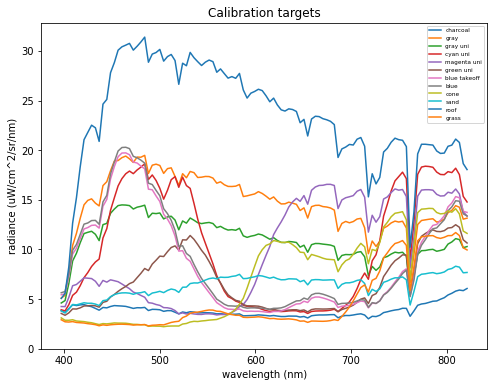

In [3]:
#external
df = pd.read_pickle("assets/openhsi_radiance_select_targets.pkl")
df.plot(x='wavelength (nm)', y=df.columns[1:],figsize=(8,6),
          xlabel="wavelength (nm)",ylabel="radiance (uW/cm^2/sr/nm)",
          ylim=(0,None),title="Calibration targets").legend(loc="upper right",fontsize='xx-small')

In [44]:
#external
#hide

speclib2 = elc.speclib.copy()
speclib2.rename(columns={"gray_small":"gray small","green_small":"green","cyan_small":"cyan","red_small":"magenta"},inplace=True)
name_dict = {"gray uni":"gray small","cyan uni":"cyan","green uni":"green",
             "magenta uni":"magenta","charcoal":"charcoal","gray":"gray","blue":"blue",
            "blue takeoff":"blue_take_off"}
name_dict2 = dict((v,k) for k,v in name_dict.items())

In [47]:
#external
#hide_input

hv.extension("bokeh",logo=False)

def get_3curves(df_col_name="blue"):
    
    #sim_df2 = spec_matcher_rad.topk_spectra(df[df_col_name],1)
    # LAB
    plot0 = hv.Curve(zip(df["wavelength (nm)"],speclib2[df_col_name]),label="Lab ASD").opts(
        fontsize={'title': 15, 'labels': 14, 'xticks': 10, 'yticks': 10,})
    
    # ELC
    spect = (np.array(df[name_dict2[df_col_name]]) - elc.b_ELC)/elc.a_ELC
    plot1 = hv.Curve(zip(df["wavelength (nm)"],spect),label="ELC estimate").opts(line_dash='dashed')
    
    # 6SV
    spect2 = np.array(df[name_dict2[df_col_name]])/elc.rad_6SV
    plot2 = hv.Curve(zip(df["wavelength (nm)"],spect2),label="6SV estimate").opts(line_dash='dotted')
    
    # Modtran
    #plot3 = hv.Curve(zip(modtran_df["wavelength (nm)"],modtran_df[df_col_name]),label="Modtran")
    
    return (plot0 * plot1 * plot2 ).opts(xlabel="wavelength (nm)",ylabel="reflectance").opts(
        title=df_col_name,ylim=(0,1),legend_position='top_left').opts({'Curve': {'color': hv.Cycle('Dark2')}})

( get_3curves("gray") + get_3curves("charcoal") + get_3curves("blue") + \
get_3curves("green") + get_3curves("magenta") + get_3curves("cyan") ).cols(3)

:Layout
   .Overlay.I   :Overlay
      .Curve.Lab_ASD        :Curve   [x]   (y)
      .Curve.ELC_estimate   :Curve   [x]   (y)
      .Curve.A_6SV_estimate :Curve   [x]   (y)
   .Overlay.II  :Overlay
      .Curve.Lab_ASD        :Curve   [x]   (y)
      .Curve.ELC_estimate   :Curve   [x]   (y)
      .Curve.A_6SV_estimate :Curve   [x]   (y)
   .Overlay.III :Overlay
      .Curve.Lab_ASD        :Curve   [x]   (y)
      .Curve.ELC_estimate   :Curve   [x]   (y)
      .Curve.A_6SV_estimate :Curve   [x]   (y)
   .Overlay.IV  :Overlay
      .Curve.Lab_ASD        :Curve   [x]   (y)
      .Curve.ELC_estimate   :Curve   [x]   (y)
      .Curve.A_6SV_estimate :Curve   [x]   (y)
   .Overlay.V   :Overlay
      .Curve.Lab_ASD        :Curve   [x]   (y)
      .Curve.ELC_estimate   :Curve   [x]   (y)
      .Curve.A_6SV_estimate :Curve   [x]   (y)
   .Overlay.VI  :Overlay
      .Curve.Lab_ASD        :Curve   [x]   (y)
      .Curve.ELC_estimate   :Curve   [x]   (y)
      .Curve.A_6SV_estimate :Curve   [x]   (y)

## Generic Interactive Datacube Viewer

For exploring your datacubes. 

In [65]:
# export

class DataCubeViewer():
    """Explore datacubes"""
    def __init__(self,nc_path:str,old_style:bool=False):
        """Load datacube at `nc_path` and setup UI."""
        
        self.nc_path = nc_path
        self.dc = DataCube(processing_lvl=-1)
        self.dc.load_nc(nc_path,old_style)
        self.RGB = self.dc.show("bokeh",robust=True).opts(height=250, width=1000, invert_yaxis=True,tools=["tap"],toolbar="below")
        self.ylim = (0,np.max(self.dc.dc.data))
        if self.ylim[1] < 7.: self.ylim = (0,1.1)
        
        self.title_txt = pn.pane.Markdown("**Interactive Datacube Viewer**",)
    
    def __call__(self):
        """Setup button callbacks and interactive stream and dynamics plots."""
        self.setup_streams()
        self.setup_callbacks()
        
        return pn.Column( self.title_txt,
                          self.RGB * self.hit_dmap * self.ch_dmap, 
                          self.tap_curve )
    
    def setup_streams(self):
        """Setup the mouseclick position and bounding box input streams."""
        # Declare Tap stream with heatmap as source and initial values
        self.posxy = hv.streams.Tap(source=self.RGB)
        
        # Declare pointer stream initializing at (0, 0) and linking to Image
        self.pointer = hv.streams.PointerXY(x=0, y=0, source=self.RGB)
        
    def setup_callbacks(self):
        """Setup the mouseover crosshair, and mouseclick callbacks."""
        # update 'x' marker on mouseclick
        def hit_mark(x,y):
            return hv.Scatter((x,y)).opts(color='r', marker='x', size=20)
        self.hit_dmap = hv.DynamicMap(hit_mark, streams=[self.posxy])
        
        # Draw cross-hair at cursor position
        def cross_hair_info(x, y):
            return hv.HLine(y) * hv.VLine(x)
        self.ch_dmap = hv.DynamicMap(cross_hair_info, streams=[self.pointer])
        
        def tap(x,y):
            if x is None or y is None:
                x = 0; y = 0
            x = int(x); y = int(y)
            
            c = self.dc.dc.data[y,x,:]
            if type(c[0]) is np.float32:
                ylabel = "radiance (uW/cm^2/sr/nm)"
                if self.ylim[1] < 1.11:
                    ylabel = "reflectance"
            else:
                ylabel = "digital number"

            return hv.Curve( zip(self.dc.binned_wavelengths,c), label="tap point").opts(xlabel="wavelength (nm)",ylabel=ylabel,
                                                                                       ylim=self.ylim)
        self.tap_curve =  hv.DynamicMap(tap, streams=[self.posxy]).opts(shared_axes=False,height=250,width=1000)


In [68]:
show_doc(DataCubeViewer.__call__)
show_doc(DataCubeViewer.setup_streams)
show_doc(DataCubeViewer.setup_callbacks)

<h4 id="DataCubeViewer.__call__" class="doc_header"><code>DataCubeViewer.__call__</code><a href="__main__.py#L17" class="source_link" style="float:right">[source]</a></h4>

> <code>DataCubeViewer.__call__</code>()

```
Setup button callbacks and interactive stream and dynamics plots.
```

<h4 id="DataCubeViewer.setup_streams" class="doc_header"><code>DataCubeViewer.setup_streams</code><a href="__main__.py#L26" class="source_link" style="float:right">[source]</a></h4>

> <code>DataCubeViewer.setup_streams</code>()

```
Setup the mouseclick position and bounding box input streams.
```

<h4 id="DataCubeViewer.setup_callbacks" class="doc_header"><code>DataCubeViewer.setup_callbacks</code><a href="__main__.py#L34" class="source_link" style="float:right">[source]</a></h4>

> <code>DataCubeViewer.setup_callbacks</code>()

```
Setup the mouseover crosshair, and mouseclick callbacks.
```

> Warning: This interactive tool requires a Python backend. There is no interactivity in the documentation site.

In [67]:
#external

dcv = DataCubeViewer(nc_path="../load_multiple/2021_12_13/2021_12_13-04_13_33_dn.nc")
dcv()

Allocated 0.00 MB of RAM.


Column
    [0] Markdown(str)
    [1] HoloViews(DynamicMap)
    [2] HoloViews(DynamicMap)